Download file-file dataset dari link berikut
https://drive.google.com/drive/folders/1X7uEqxTdNVW83zNGkVp3gR25GMwFoZzS?usp=sharing
lalu upload ke Google Drive (akun yang sama yang digunakan pada Colab) pada direktori: My Drive/Colab Notebooks/DATASET/COCO

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Install detectron2

In [ ]:
!pip install pyyaml==5.1
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 3.9 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44089 sha256=3c30eeefa20784dc4f9976f1318513ca39c6b22123a7cd2907a1c38db07a141b
  Stored in directory: /root/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/de

In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.13")

1.13.0+cu116 True


In [ ]:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

## Downloading Datasets

## Prepare the datasets

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("broilersTrain_01", {}, "/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/train.json", "/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO")
register_coco_instances("broilersVal_01", {}, "/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/val.json", "/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO")

AssertionError: ignored

In [ ]:
broilersTrain_metadata = MetadataCatalog.get("broilersTrain_01")
broilersVal_metadata = MetadataCatalog.get("broilersVal_01")

In [ ]:
broilersTrain_metadata

Metadata(evaluator_type='coco', image_root='/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO', json_file='/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/train.json', name='broilersTrain_01', thing_classes=['broiler'], thing_dataset_id_to_contiguous_id={0: 0})

In [ ]:
broilersVal_metadata

Metadata(evaluator_type='coco', image_root='/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO', json_file='/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/val.json', name='broilersVal_01', thing_classes=['broiler'], thing_dataset_id_to_contiguous_id={0: 0})

## Visualize the datasets

In [ ]:
broilersTrain_dataset_dicts = DatasetCatalog.get("broilersTrain_01")
broilersVal_dataset_dicts = DatasetCatalog.get("broilersVal_01")

WARNING [12/23 15:18:46 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/23 15:18:46 d2.data.datasets.coco]: Loaded 86 images in COCO format from /content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/train.json
WARNING [12/23 15:18:46 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/23 15:18:46 d2.data.datasets.coco]: Loaded 22 images in COCO format from /content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/val.json


In [ ]:
len(broilersTrain_dataset_dicts)

86

In [ ]:
len(broilersVal_dataset_dicts)

22

In [ ]:
broilersTrain_dataset_dicts[0].keys()

dict_keys(['file_name', 'height', 'width', 'image_id', 'annotations'])

In [ ]:
broilersVal_dataset_dicts[0].keys()

dict_keys(['file_name', 'height', 'width', 'image_id', 'annotations'])

In [ ]:
broilersTrain_dataset_dicts[0]['annotations'][0]

{'iscrowd': 0,
 'bbox': [956.2248995983934,
  586.3453815261043,
  140.96385542168673,
  120.48192771084337],
 'category_id': 0,
 'segmentation': [[1090,
   593,
   1097,
   613,
   1092,
   622,
   1093,
   640,
   1092,
   657,
   1079,
   683,
   1066,
   696,
   1049,
   705,
   1029,
   706,
   1013,
   705,
   986,
   702,
   978,
   689,
   968,
   684,
   956,
   679,
   956,
   660,
   961,
   638,
   971,
   616,
   987,
   599,
   1019,
   586,
   1046,
   590,
   1061,
   595,
   1078,
   592,
   1083,
   589]],
 'bbox_mode': <BoxMode.XYWH_ABS: 1>}

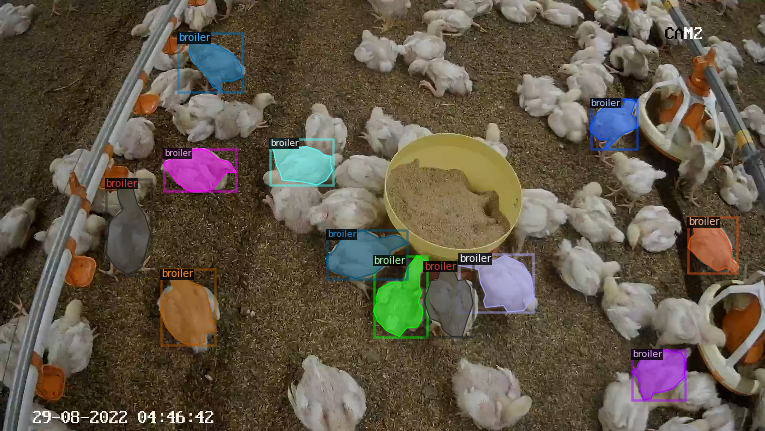

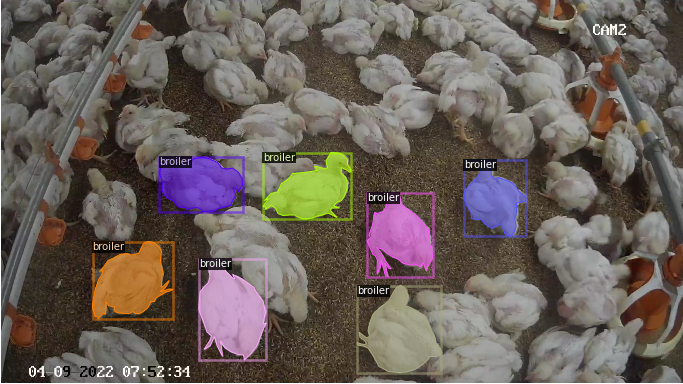

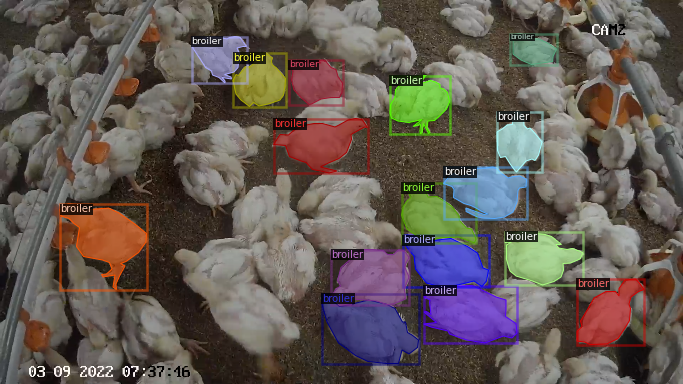

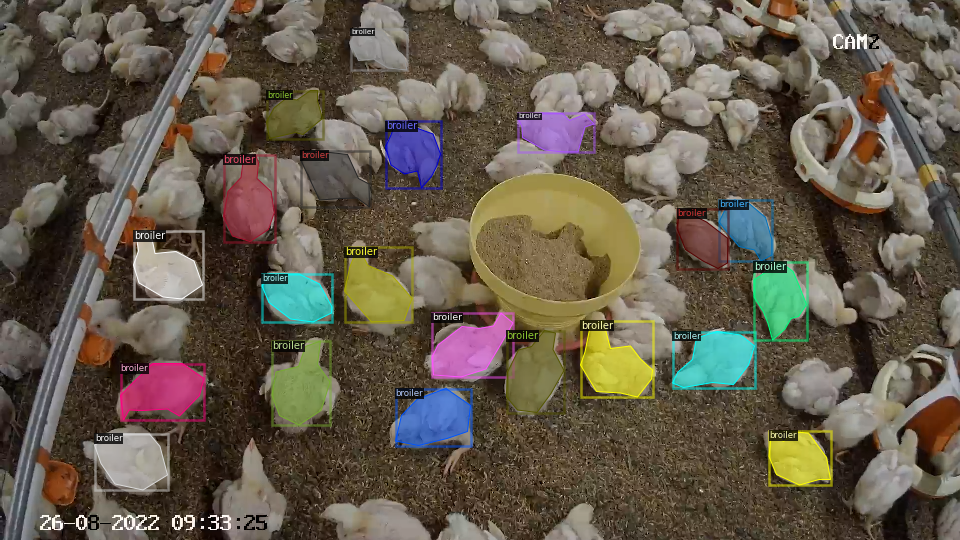

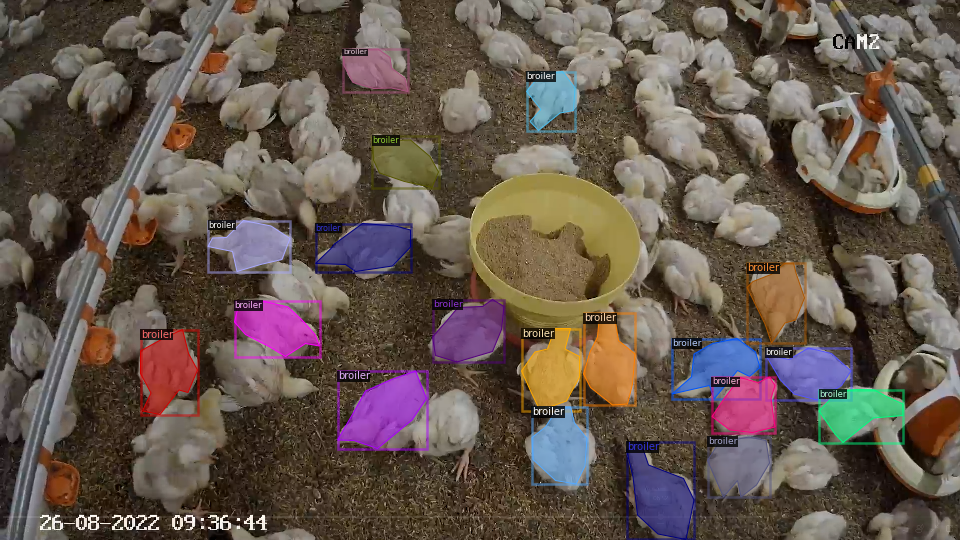

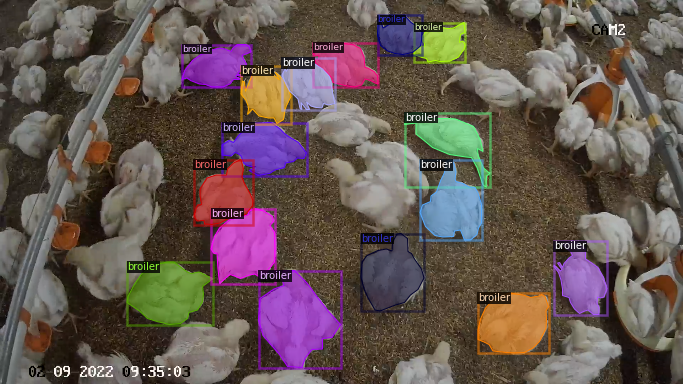

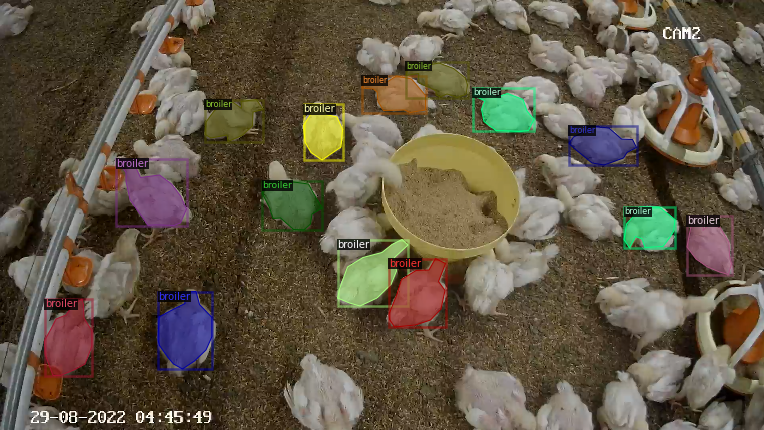

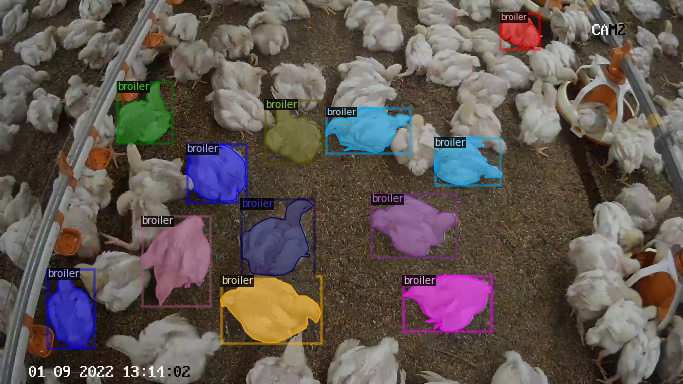

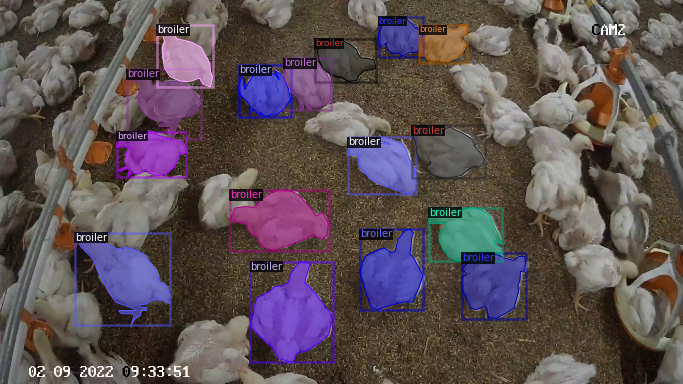

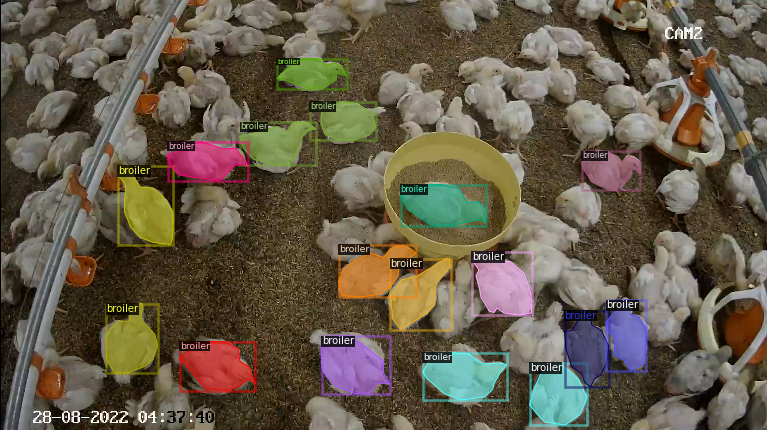

In [ ]:
for d in random.sample(broilersTrain_dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=broilersTrain_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

Ini adalah visualisasi 10 data random yang telah di segmentasi menggunakan labelme

# Instance Segmentation Model

## Setting up the model

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
config_name = "COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x.yaml"
cfg.merge_from_file(model_zoo.get_config_file(config_name))
cfg.DATASETS.TRAIN = ("broilersTrain_01",)
cfg.DATASETS.TEST = ("broilersVal_01",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(config_name)
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)

[12/23 12:40:45 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_9243eb.pkl: 144MB [00:17, 8.19MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


In [ ]:
trainer.train()

[12/23 12:41:08 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[12/23 12:41:33 d2.utils.events]:  eta: 0:11:45  iter: 19  total_loss: 2.512  loss_cls: 0.7277  loss_box_reg: 0.7278  loss_mask: 0.688  loss_rpn_cls: 0.3059  loss_rpn_loc: 0.04715  time: 0.8282  data_time: 0.2630  lr: 4.9953e-06  max_mem: 2135M
[12/23 12:41:46 d2.utils.events]:  eta: 0:10:45  iter: 39  total_loss: 2.425  loss_cls: 0.6932  loss_box_reg: 0.7572  loss_mask: 0.6799  loss_rpn_cls: 0.2754  loss_rpn_loc: 0.04047  time: 0.7266  data_time: 0.0826  lr: 9.9902e-06  max_mem: 2135M
[12/23 12:41:58 d2.utils.events]:  eta: 0:09:48  iter: 59  total_loss: 2.31  loss_cls: 0.6056  loss_box_reg: 0.7518  loss_mask: 0.6624  loss_rpn_cls: 0.2259  loss_rpn_loc: 0.04026  time: 0.6841  data_time: 0.0158  lr: 1.4985e-05  max_mem: 2135M
[12/23 12:42:10 d2.utils.events]:  eta: 0:09:24  iter: 79  total_loss: 2.264  loss_cls: 0.565  loss_box_reg: 0.7908  loss_mask: 0.6375  loss_rpn_cls: 0.2198  loss_rpn_loc: 0.03391  time: 0.6603  data_time: 0.0080  lr: 1.998e-05  max_mem: 2135M
[12/23 12:42:22 d2.u

## Creating a predictor

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)

[12/23 15:19:10 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


## Visualizing Inferences

WARNING [12/23 15:19:15 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/23 15:19:15 d2.data.datasets.coco]: Loaded 86 images in COCO format from /content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/train.json


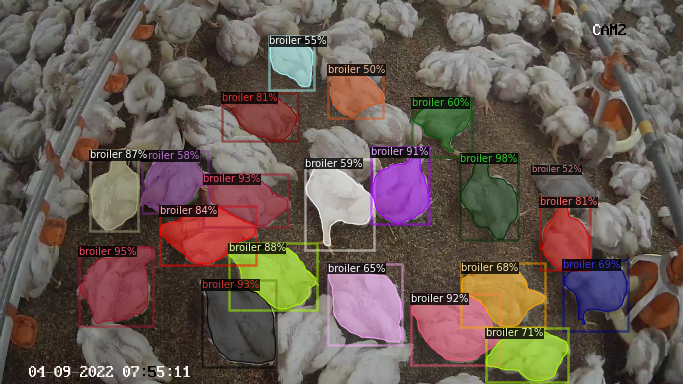

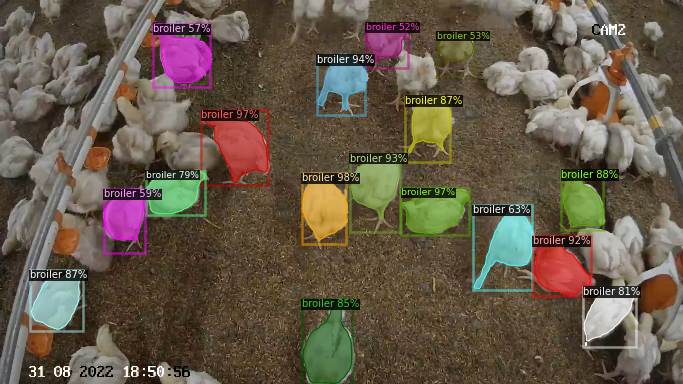

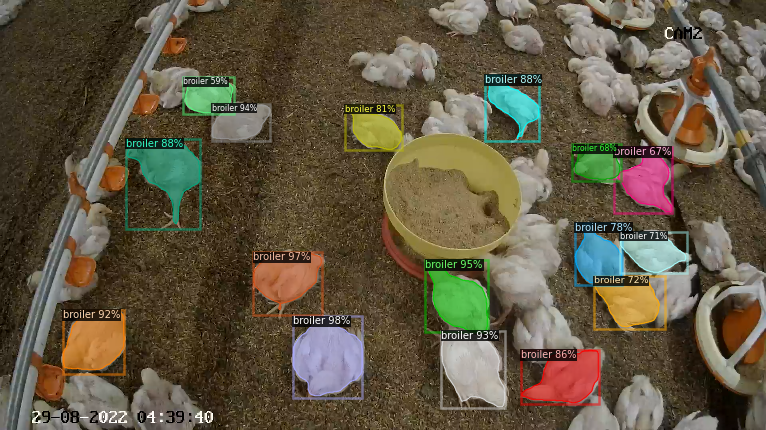

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("broilersTrain_01")
for d in random.sample(dataset_dicts, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=broilersTrain_metadata,
                   scale=0.5,
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

{'instances': Instances(num_instances=24, image_height=1080, image_width=1920, fields=[pred_boxes: Boxes(tensor([[1370.0721,  609.2322, 1489.9163,  729.7189],
        [1125.3082,  648.5569, 1239.2623,  812.2083],
        [ 499.2836,  446.9977,  648.0099,  558.6146],
        [ 635.9296,  345.0535,  786.8067,  465.6565],
        [ 984.0500,  666.0545, 1113.4363,  814.2452],
        [ 742.9309,  583.7294,  938.7386,  694.0656],
        [ 868.5947,  633.1413, 1022.2039,  774.5341],
        [ 688.8992,  183.9238,  791.2790,  279.2386],
        [1297.9708,  448.2847, 1446.8611,  547.5206],
        [1214.6266,  614.1826, 1331.2407,  771.0406],
        [1371.5428,  748.3943, 1509.9789,  886.3206],
        [1468.2520,  935.0517, 1643.2378, 1072.3441],
        [1329.5728,  140.0300, 1474.8409,  247.7252],
        [1020.8467,  206.3449, 1155.5090,  350.0925],
        [  24.8443,  246.8903,  136.0495,  351.9739],
        [ 152.8472,  735.2034,  298.5157,  862.4918],
        [1297.4478,  312.0365, 

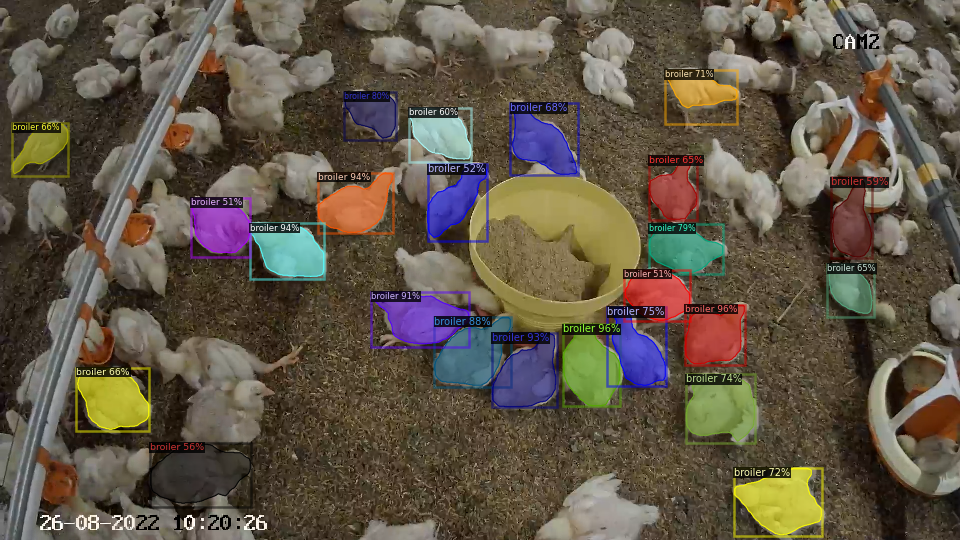

In [ ]:
im = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/Data 1_1.png")
outputs = predictor(im)
print(outputs)
v = Visualizer(im[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
masks = outputs['instances'].pred_masks
masks.shape

torch.Size([24, 1080, 1920])

In [ ]:
torch.sum(torch.flatten(masks, start_dim=1),dim=1)

tensor([10656, 12827, 11610, 10822, 12972, 13034, 13329,  6471,  9830,  9792,
        14086, 15087,  7037, 10527,  5881, 12717,  7489,  6214,  8886,  8232,
        17566,  8639,  9833,  9546], device='cuda:0')

Berikut ini adalah luas pixel masing-masing segmentasi ayam pada gambar

In [ ]:
luas = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

print(luas)

[10656, 12827, 11610, 10822, 12972, 13034, 13329, 6471, 9830, 9792, 14086, 15087, 7037, 10527, 5881, 12717, 7489, 6214, 8886, 8232, 17566, 8639, 9833, 9546]


In [ ]:
#Menghitung rata-rata pada list
A = len(Luas)
total_luas = 0
rata2_luas = 0
for i in Luas:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

0.010544392500000001


**PREDIKSI BERAT**

Persamaan Regresi : 0.0013084875429176768 x^2 + 0.01614099172530554 x +  0.05798509943228436


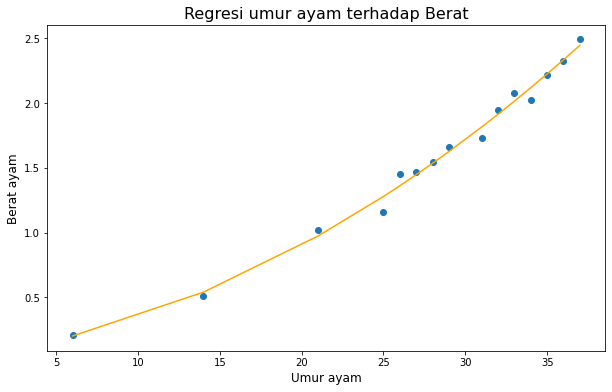

In [ ]:
'''
Dari tabel berat kita dapatkan bahwa data berat diambil hari ke 6 hingga ke 37
Sedangkan data pada kamera hanya diambil dari hari ke 8 hingga hari ke 23
Maka regresi dilakukan juga di hari tersebut
'''

hari_berat = [6, 14, 21, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35, 36, 37]
nilai_berat = [0.21, 0.51, 1.02, 1.16, 1.4552, 1.466, 1.543, 1.659, 1.733, 1.951, 2.076, 2.023, 2.22, 2.322, 2.492]

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures

x = np.array(hari_berat).reshape(-1,1)
y = np.array(nilai_berat)
poly = PolynomialFeatures(degree=2, include_bias= True)
poly_features = poly.fit_transform(x.reshape(-1, 1))

poly_reg_model = LinearRegression()
model = poly_reg_model.fit(poly_features, y)
y_predicted = poly_reg_model.predict(poly_features)

r_sq = model.score(poly_features, y)

#Persamaan Regresi
y_pred = model.predict(poly_features)
print("Persamaan Regresi :",model.coef_[2],"x^2 +",model.coef_[1],"x + ",model.intercept_)

plt.figure(figsize=(10, 6))
plt.title("Regresi umur ayam terhadap Berat", size=16)
plt.xlabel("Umur ayam",size =12)
plt.ylabel("Berat ayam",size =12)
plt.scatter(x, y)
plt.plot(x, y_predicted, c="orange")
plt.show()

**Prediksi Berat dari Luas**

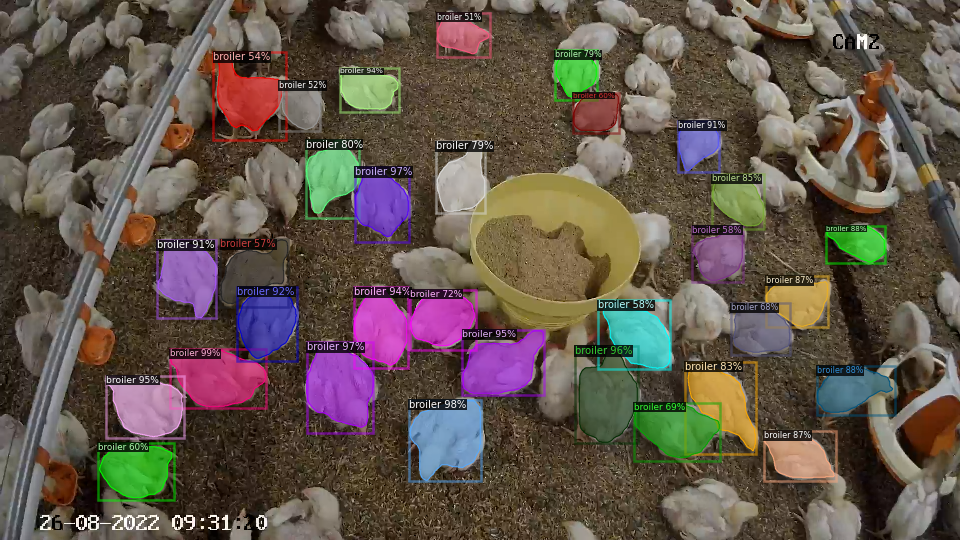

10389.84375


In [ ]:
#Menghitung Luas untuk Setiap Hari dan mengumpulkan rata-ratanya

#Day_1

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day1_ (1).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i
rata2_luas = total_luas/A
print(rata2_luas)

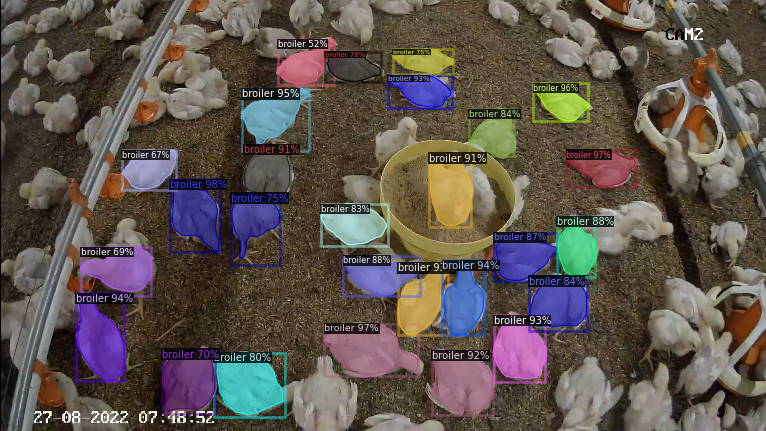

7890.037037037037


In [ ]:
#Day_2

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day2_ (1).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

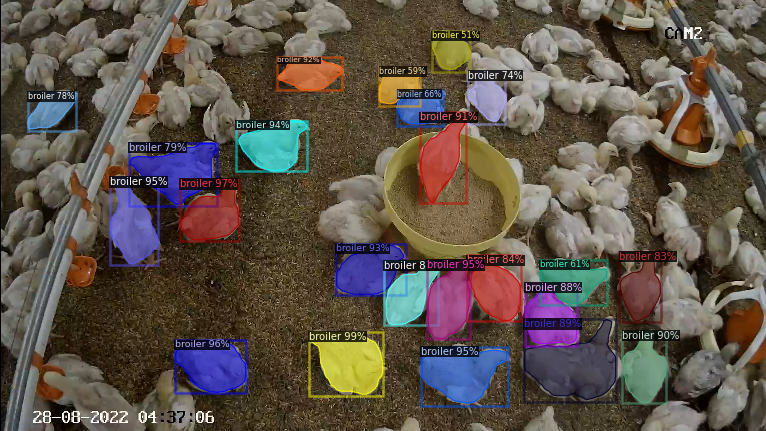

8623.130434782608


In [ ]:
#Day_3

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day3_ (7).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

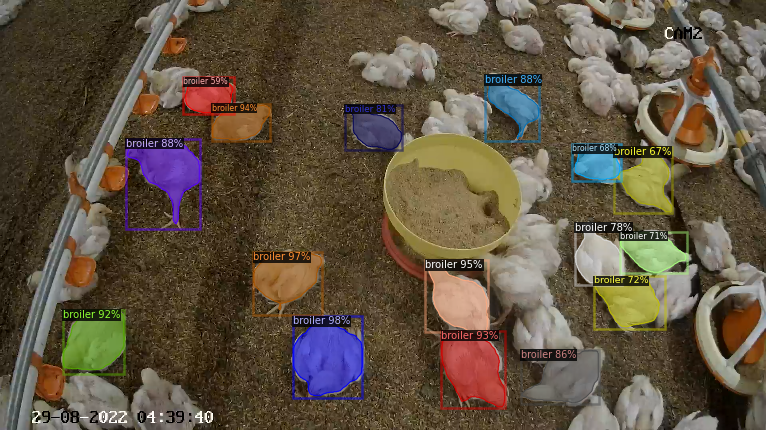

8981.0


In [ ]:
#Day_4

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day4_ (2).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

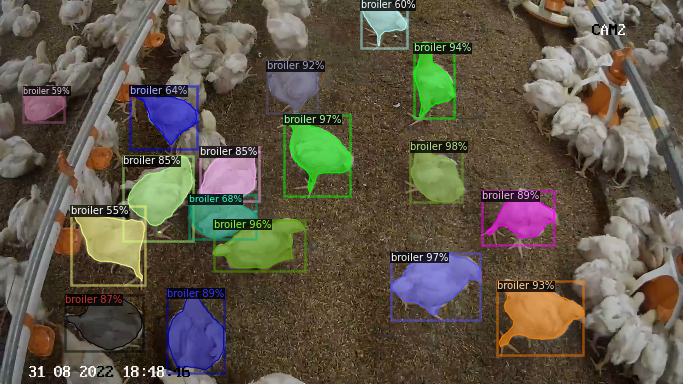

8897.529411764706


In [ ]:
#Day_5

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day5_ (8).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

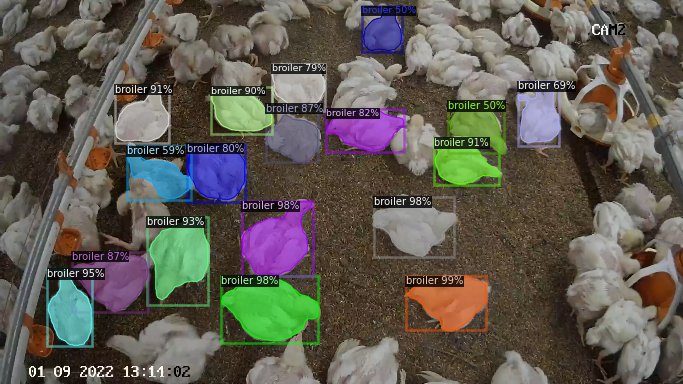

9213.666666666666


In [ ]:
#Day_6

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day6_ (5).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

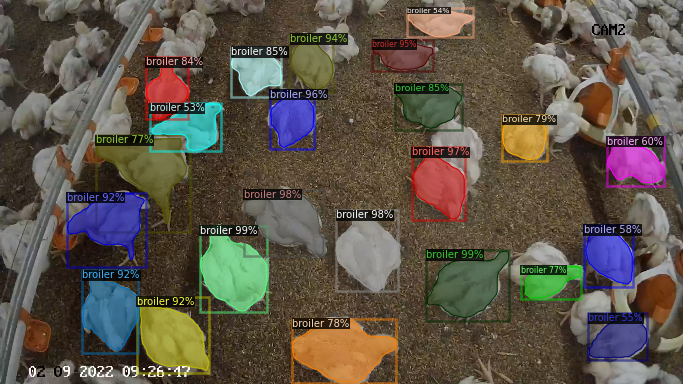

9355.04347826087


In [ ]:
#Day_7

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day7_ (1).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

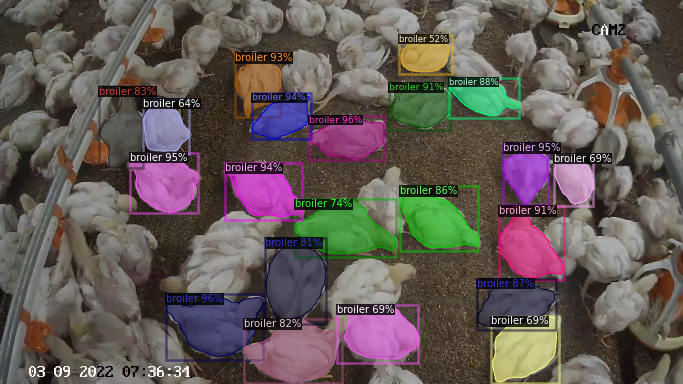

10013.0


In [ ]:
#Day_8

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day8_ (5).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

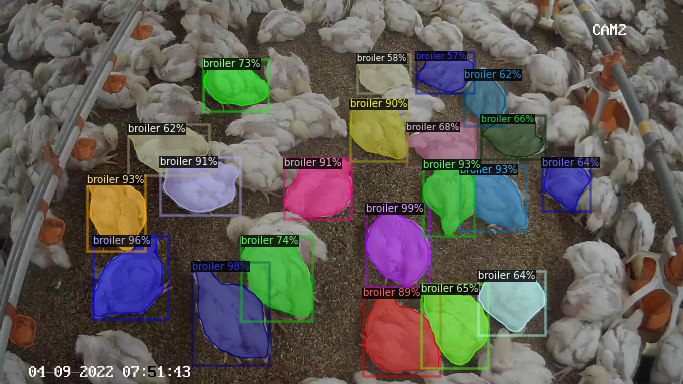

10885.380952380952


In [ ]:
#Day_9

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day9_ (5).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

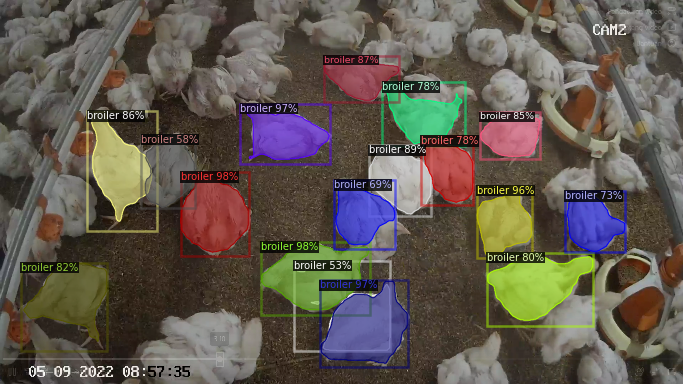

12532.882352941177


In [ ]:
#Day_10

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day10_ (5).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

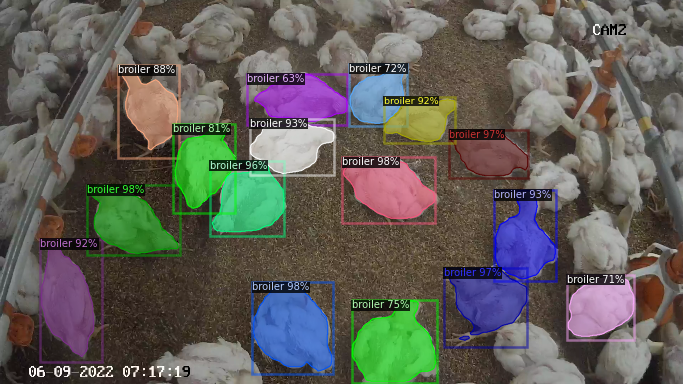

13322.4375


In [ ]:
#Day_11

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day11_ (9).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

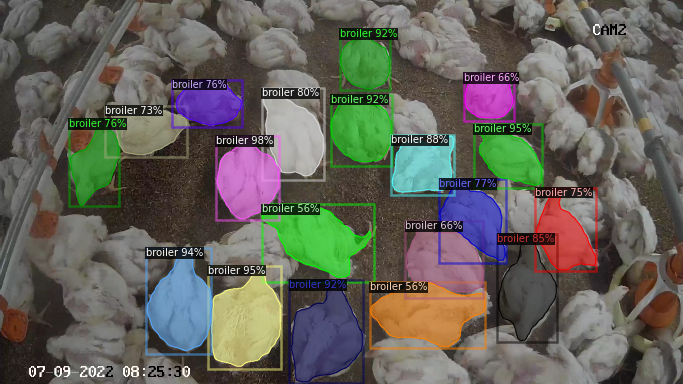

13214.578947368422


In [ ]:
#Day_12

img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/COCO/Day12_ (3).png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print(rata2_luas)

In [ ]:
#Prediksi berat berdasarkan umur di video

umur = [11,12,13,14,16,17,18,19,20,21,22,23]
Luas = [10389.84375, 7890.037037037037, 8623.130434782608, 8981.0, 8897.529411764706, 9213.666666666666, 9355.04347826087, 10013.0, 10885.380952380952, 12532.882352941177, 13322.4375, 13214.578947368422]
berat = []
for i in umur:
  berat_ayam = model.coef_[2]*i**2 + model.coef_[1]*i + model.intercept_
  berat.append(berat_ayam)
print(berat)

[0.3938630011036842, 0.44009920631609634, 0.4889523866143438, 0.5404225419984267, 0.6512137780240983, 0.7105348586656872, 0.7724729143931114, 0.837027945206371, 0.9041999511054659, 0.9739889320903963, 1.0463948881611618, 1.1214178193177629]


In [ ]:
#Split data menjadi Data Latih dan Data Validasi
from sklearn.model_selection import train_test_split #diperbolehkan

X= np.array(Luas)

X_train, X_test, y_train, y_test = train_test_split(X, berat, test_size=0.33, random_state=42)

Persamaan Regresi : 3.300590349962036e-10 x^2 + 0.00010316998413594406 x +  -0.3560683801163239


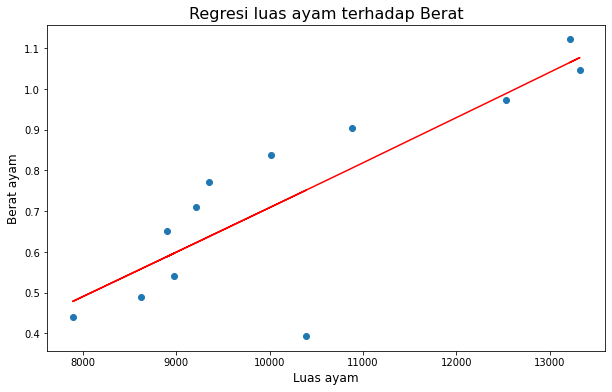

In [ ]:
#Prediksi berat berdasarkan luas

x_b = np.array(Luas).reshape(-1,1)
y_b = np.array(berat)
poly = PolynomialFeatures(degree=2, include_bias= True)
poly_features = poly.fit_transform(x_b.reshape(-1, 1))

poly_reg_model = LinearRegression()
model1 = poly_reg_model.fit(poly_features, y_b)
y_predicted = poly_reg_model.predict(poly_features)

r_sq = model.score(poly_features, y_b)

#Persamaan Regresi
y_pred = model.predict(poly_features)
print("Persamaan Regresi :",model1.coef_[2],"x^2 +",model1.coef_[1],"x + ",model1.intercept_)

plt.figure(figsize=(10, 6))
plt.title("Regresi luas ayam terhadap Berat", size=16)
plt.xlabel("Luas ayam",size =12)
plt.ylabel("Berat ayam",size =12)
plt.scatter(x_b, y_b)
plt.plot(x_b, y_predicted, c="red")
plt.show()

In [ ]:
def fit_polynomial(x, t, Npoly):
  Ndata = len(x)
  # Npoly is degree of the polynomial
  X = np.zeros( (Ndata,Npoly+1) )
  X[:,0] = 1
  for i in range(1,Npoly+1):
    X[:,i] = np.power( x, i )
  XtX = X.transpose() @ X
  XtXinv = np.linalg.inv(XtX)
  w = XtXinv @ X.transpose() @ t
  return X, w
def predict_polynomial(w, x_eval):
  Npoly = w.shape[0] - 1
  Ndata_eval = x_eval.shape[0]
  # Build X matrix for new input
  X_eval = np.zeros( (Ndata_eval,Npoly+1) )
  X_eval[:,0] = 1.0
  for i in range(1,Npoly+1):
    X_eval[:,i] = np.power( x_eval, i )
  # evaluate
  t_eval = X_eval @ w
  return t_eval

W = []
loss = [0 for i in range(9)]
for Npoly in range(1,10):
  X, w = fit_polynomial(X_train, y_train, Npoly)
  W.append(w)
  t_val_pred = predict_polynomial(w, X_test)
  loss_w = np.sum( (t_val_pred - y_test)**2/len(y_test) )
  loss[Npoly-1] = loss_w
  print("Orde_Polynom = %2d , loss = %10.32f" % (Npoly, loss_w))

Orde_Polynom =  1 , loss = 0.05067904116247552021023992097071
Orde_Polynom =  2 , loss = 0.06537553916601433756650152417933
Orde_Polynom =  3 , loss = 0.10123082927339413505940513005044
Orde_Polynom =  4 , loss = 0.31897652172263513126182488122140
Orde_Polynom =  5 , loss = 7.18968545813824988499618484638631
Orde_Polynom =  6 , loss = 15.12445793873765609305337420664728
Orde_Polynom =  7 , loss = 133.58572528732187834066280629485846
Orde_Polynom =  8 , loss = 60.37153086892581654865352902561426
Orde_Polynom =  9 , loss = 18171.70630106894532218575477600097656


Dari Data di atas diketahui bahwa polynom orde 1 yang paling mendekati dengan nilainya

# This is a polynomial of order 2.
# This is a polynomial of order 3.
# This is a polynomial of order 4.
# This is a polynomial of order 5.
# This is a polynomial of order 6.
# This is a polynomial of order 7.
# This is a polynomial of order 8.
# This is a polynomial of order 9.
# This is a polynomial of order 10.


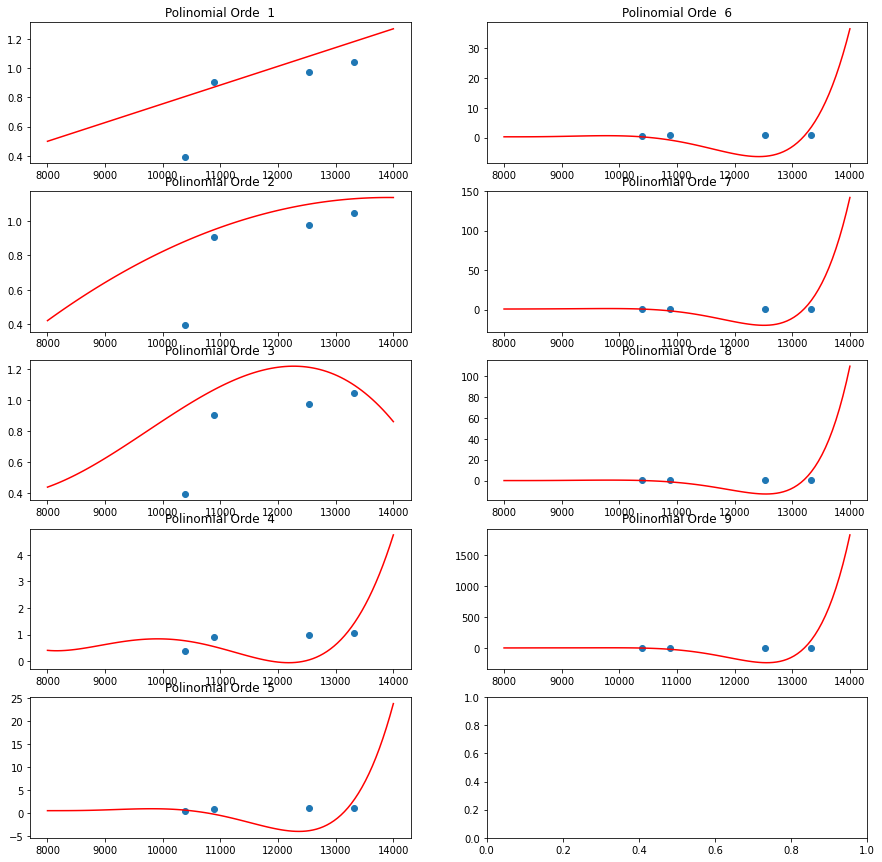

In [ ]:
#Plot Setiap Polinomial

import matplotlib.pyplot as plt
import matplotlib

def PolyCoefficients(x, coeffs):
    """ Returns a polynomial for ``x`` values for the ``coeffs`` provided.

    The coefficients must be in ascending order (``x**0`` to ``x**o``).
    """
    o = len(coeffs)
    print(f'# This is a polynomial of order {o}.')
    y = np.zeros(len(x))
    for i in range(o):
      for j in range(len(x)):
        y[j] += coeffs[i]*x[j]**i
    return y

figure, ax = plt.subplots(5, 2, figsize = (15, 15))
for Npoly in range(0,9):
  xr = np.linspace(8000,14000, 100)
  if Npoly > 4:
    ax[Npoly-5,1].plot(xr, PolyCoefficients(xr, W[Npoly]), c = "red")
    ax[Npoly-5,1].scatter(X_test, y_test)
    ax[Npoly-5,1].set_title("Polinomial Orde %2d"%(Npoly+1))
  else:
    ax[Npoly,0].plot(xr, PolyCoefficients(xr, W[Npoly]), c = "red")
    ax[Npoly,0].scatter(X_test, y_test)
    ax[Npoly,0].set_title("Polinomial Orde %2d"%(Npoly+1))
plt.show()

PREDIKTOR FINAL

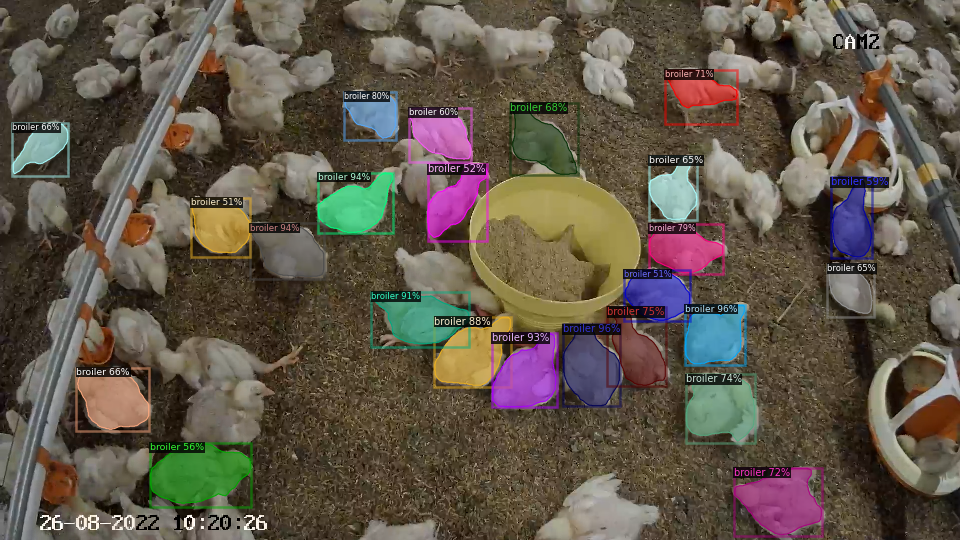

luas ayam dengan pixel gambar adalah 10545.125
berat ayam adalah 0.7685744517344603


In [ ]:
img = cv2.imread("/content/drive/MyDrive/Colab Notebooks_01/DATASET/Data 1_1.png")
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
                metadata=broilersTrain_metadata,
                scale=0.5,
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

masks = outputs['instances'].pred_masks
luas_1 = torch.sum(torch.flatten(masks, start_dim=1),dim=1).cpu().detach().numpy().tolist()

#Menghitung rata-rata pada list
A = len(luas_1)
total_luas = 0
rata2_luas = 0
for i in luas_1:
  total_luas += i

rata2_luas = total_luas/A
print("luas ayam dengan pixel gambar adalah", rata2_luas)
berat_ayam_pred = model1.coef_[2]*rata2_luas**2+model1.coef_[1]*rata2_luas+model1.intercept_
print("berat ayam adalah",berat_ayam_pred)
